# Graph with Networkx

In this notebook, we explored Networkx package using PDAC B2 data (image + center nuclei coordinates).

We pursue the exploration in the script **graph_clustering_networkx.ipynb**

# 0. Import packages and data

pip install opencv-python

pip install contextily

pip install Shapely

pip install geopandas

pip install --upgrade networkx[default]

pip install libpysal

pip install plotly

In [1]:
import libpysal
from libpysal import weights, examples
from libpysal.cg import voronoi_frames
from contextily import add_basemap
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import json
import cv2

#allow spatial operations on geometric types
import geopandas

# for visualization
import plotly.express as px
import pandas as pd

In [2]:
input_images = "./input_images"
input_coordinates = "./nuclei_coordinates"

In [2]:
with open(f"output_coords/nucleus_coords_B2_wo_background.json", 'r') as file:
    nucleus_coords = json.load(file)

In [5]:
img = cv2.imread(f'input_images/PDAC_ILS50185PT2_B2.jpg', cv2.IMREAD_GRAYSCALE)

In [6]:
nucleus_coords

[[6395, 14596],
 [6511, 14837],
 [6525, 14822],
 [6585, 14820],
 [6587, 14818],
 [6567, 14818],
 [6573, 14817],
 [6547, 14816],
 [6588, 14815],
 [6538, 14815],
 [6551, 14814],
 [6536, 14813],
 [6541, 14799],
 [6475, 14794],
 [6527, 14792],
 [6505, 14791],
 [6468, 14791],
 [6519, 14789],
 [6517, 14788],
 [6528, 14785],
 [6530, 14784],
 [6523, 14781],
 [6548, 14780],
 [6568, 14779],
 [6539, 14779],
 [6545, 14790],
 [6564, 14773],
 [6497, 14769],
 [6459, 14768],
 [6543, 14766],
 [6542, 14765],
 [6490, 14765],
 [6539, 14762],
 [6486, 14762],
 [6482, 14760],
 [6523, 14754],
 [6555, 14753],
 [6497, 14753],
 [6530, 14751],
 [6534, 14750],
 [6545, 14749],
 [6544, 14748],
 [6481, 14747],
 [6508, 14746],
 [6541, 14743],
 [6528, 14743],
 [6515, 14743],
 [6572, 14742],
 [6527, 14742],
 [6488, 14742],
 [6494, 14741],
 [6459, 14740],
 [6546, 14737],
 [6539, 14736],
 [6492, 14736],
 [6499, 14735],
 [6536, 14734],
 [6512, 14734],
 [6472, 14728],
 [6497, 14724],
 [6484, 14723],
 [6473, 14720],
 [6479, 

# 1. Delaunay and Voronoï

In [7]:
cells, generators = voronoi_frames(nucleus_coords, clip="convex hull")

In [8]:
cells

,geometry
0,"POLYGON ((6363.701 14688.171, 6464.790 14617.9..."
1,"POLYGON ((6444.096 14856.443, 6437.633 14862.4..."
2,"POLYGON ((6502.203 14814.756, 6545.988 14855.6..."
3,"POLYGON ((6566.161 14907.553, 6618.438 15135.1..."
4,"POLYGON ((6786.249 15019.249, 6889.200 14917.0..."
...,...
313759,"POLYGON ((13706.822 177.586, 13697.521 155.882..."
313760,"POLYGON ((13662.702 177.780, 13665.143 179.768..."
313761,"POLYGON ((13780.723 175.931, 13805.470 163.182..."
313762,"POLYGON ((13601.500 157.500, 13610.265 166.265..."


In [9]:
generators

,geometry
0,POINT (6395.000 14596.000)
1,POINT (6511.000 14837.000)
2,POINT (6525.000 14822.000)
3,POINT (6585.000 14820.000)
4,POINT (6587.000 14818.000)
...,...
313759,POINT (13689.000 165.000)
313760,POINT (13686.000 161.000)
313761,POINT (13775.000 158.000)
313762,POINT (13615.000 158.000)


In [10]:
delaunay = weights.Rook.from_dataframe(cells)

In [11]:
delaunay

In [12]:
delaunay_graph = delaunay.to_networkx()

In [13]:
delaunay_graph

In [14]:
delaunay_graph.nodes

NodeView((0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 

In [15]:
positions = dict(zip(delaunay_graph.nodes, nucleus_coords))

In [16]:
positions

{0: [6395, 14596],
 1: [6511, 14837],
 2: [6525, 14822],
 3: [6585, 14820],
 4: [6587, 14818],
 5: [6567, 14818],
 6: [6573, 14817],
 7: [6547, 14816],
 8: [6588, 14815],
 9: [6538, 14815],
 10: [6551, 14814],
 11: [6536, 14813],
 12: [6541, 14799],
 13: [6475, 14794],
 14: [6527, 14792],
 15: [6505, 14791],
 16: [6468, 14791],
 17: [6519, 14789],
 18: [6517, 14788],
 19: [6528, 14785],
 20: [6530, 14784],
 21: [6523, 14781],
 22: [6548, 14780],
 23: [6568, 14779],
 24: [6539, 14779],
 25: [6545, 14790],
 26: [6564, 14773],
 27: [6497, 14769],
 28: [6459, 14768],
 29: [6543, 14766],
 30: [6542, 14765],
 31: [6490, 14765],
 32: [6539, 14762],
 33: [6486, 14762],
 34: [6482, 14760],
 35: [6523, 14754],
 36: [6555, 14753],
 37: [6497, 14753],
 38: [6530, 14751],
 39: [6534, 14750],
 40: [6545, 14749],
 41: [6544, 14748],
 42: [6481, 14747],
 43: [6508, 14746],
 44: [6541, 14743],
 45: [6528, 14743],
 46: [6515, 14743],
 47: [6572, 14742],
 48: [6527, 14742],
 49: [6488, 14742],
 50: [6494

In [17]:
positions_test = dict(zip(range(1,135506) , nucleus_coords))
positions_test

{1: [6395, 14596],
 2: [6511, 14837],
 3: [6525, 14822],
 4: [6585, 14820],
 5: [6587, 14818],
 6: [6567, 14818],
 7: [6573, 14817],
 8: [6547, 14816],
 9: [6588, 14815],
 10: [6538, 14815],
 11: [6551, 14814],
 12: [6536, 14813],
 13: [6541, 14799],
 14: [6475, 14794],
 15: [6527, 14792],
 16: [6505, 14791],
 17: [6468, 14791],
 18: [6519, 14789],
 19: [6517, 14788],
 20: [6528, 14785],
 21: [6530, 14784],
 22: [6523, 14781],
 23: [6548, 14780],
 24: [6568, 14779],
 25: [6539, 14779],
 26: [6545, 14790],
 27: [6564, 14773],
 28: [6497, 14769],
 29: [6459, 14768],
 30: [6543, 14766],
 31: [6542, 14765],
 32: [6490, 14765],
 33: [6539, 14762],
 34: [6486, 14762],
 35: [6482, 14760],
 36: [6523, 14754],
 37: [6555, 14753],
 38: [6497, 14753],
 39: [6530, 14751],
 40: [6534, 14750],
 41: [6545, 14749],
 42: [6544, 14748],
 43: [6481, 14747],
 44: [6508, 14746],
 45: [6541, 14743],
 46: [6528, 14743],
 47: [6515, 14743],
 48: [6572, 14742],
 49: [6527, 14742],
 50: [6488, 14742],
 51: [649

nx.draw keywords :
- https://networkx.org/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html

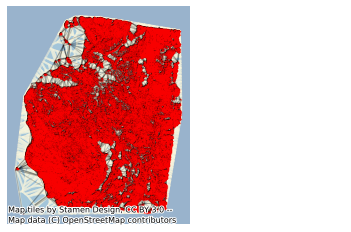

In [18]:
ax = cells.plot(facecolor="lightblue", alpha=0.50, edgecolor="cornsilk", linewidth=2)
add_basemap(ax)
ax.axis("off")
nx.draw(
    delaunay_graph,
    positions,
    ax=ax,
    node_size=0.1,
    node_color="red",
    edge_color="k",
    alpha=0.2,
)
plt.show()

In [19]:
delaunay_graph.number_of_edges()

939811

In [20]:
delaunay_graph.number_of_nodes()

313764

## Export graph as graphml

In [21]:
nx.write_graphml(delaunay_graph, "./graph/B2_delaunay_graph.graphml")

# 2. Edges contraction

In [26]:
delaunay_dedensify_graph, delaunay_dedensify_nodes = nx.summarization.dedensify(delaunay_graph, 2)

In [27]:
c_nodes = list(delaunay_dedensify_nodes)
c_nodes

[]

In [16]:
delaunay_dedensify_graph.number_of_edges()

406100

In [17]:
delaunay_dedensify_graph.number_of_nodes()

135506

In [ ]:
ax = cells.plot(facecolor="lightblue", alpha=0.50, edgecolor="cornsilk", linewidth=2)
add_basemap(ax)
ax.axis("off")
nx.draw(
    delaunay_dedensify_graph,
    positions = new_positions,
    ax=ax,
    node_size=0.1,
    node_color="red",
    edge_color="k",
    alpha=0.8,
)
plt.show()

# 3. Snap aggregation

Can't perfom this method because we don't have nodes attributes

https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.summarization.snap_aggregation.html#networkx.algorithms.summarization.snap_aggregation

In [19]:
nodes = delaunay_graph.nodes()

In [24]:
nodes

NodeView((0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 

In [20]:
for node in nodes:
    attributes = nodes[node]
    delaunay_graph.add_node(node, **attributes)

In [23]:
attributes

{}

In [21]:
delaunay_sa = nx.snap_aggregation(delaunay_graph,attributes, prefix='Supernode-', supernode_attribute='group', superedge_attribute='types')

In [22]:
delaunay_sa.number_of_edges()

1

# 4. Node-grouping techniques

In [26]:
supernodes = list(nx.connected_components(delaunay_graph)) 

In [28]:
len(supernodes)

1

In [29]:
delaunay_graph.edges

EdgeView([(0, 2), (0, 3021), (0, 3082), (0, 3083), (0, 3201), (0, 3202), (0, 3204), (0, 18422), (1, 19), (1, 95), (1, 103), (1, 105), (1, 106), (1, 112), (1, 113), (1, 192), (1, 197), (1, 748), (2, 3368), (2, 18422), (2, 18423), (2, 18425), (2, 18428), (2, 18430), (2, 18441), (3, 10), (3, 167), (3, 168), (4, 5), (4, 6), (4, 7), (4, 12), (4, 38), (5, 6), (5, 11), (5, 12), (5, 904), (5, 905), (6, 7), (6, 8), (6, 15), (6, 16), (6, 83), (7, 8), (7, 38), (8, 25), (8, 38), (8, 75), (8, 83), (9, 10), (9, 18), (9, 85), (9, 170), (9, 175), (10, 50), (10, 168), (10, 170), (11, 12), (11, 905), (11, 915), (11, 930), (12, 38), (12, 930), (12, 950), (13, 14), (13, 15), (13, 16), (13, 21), (13, 56), (13, 58), (13, 167), (14, 16), (14, 56), (14, 83), (14, 92), (15, 16), (16, 83), (17, 26), (17, 28), (17, 49), (17, 77), (17, 108), (17, 206), (17, 478), (17, 479), (18, 85), (18, 87), (19, 22), (19, 24), (19, 36), (19, 52), (19, 53), (19, 54), (19, 61), (19, 95), (19, 106), (20, 66), (20, 105), (20, 112)

# 5. Edge-grouping techniques

### Apply **weight = 1**

In [44]:
nx.set_edge_attributes(delaunay_graph, values = 1, name = 'weight')

In [47]:
delaunay_graph.edges(data = True)

EdgeDataView([(0, 2, {'weight': 1}), (0, 3021, {'weight': 1}), (0, 3082, {'weight': 1}), (0, 3083, {'weight': 1}), (0, 3201, {'weight': 1}), (0, 3202, {'weight': 1}), (0, 3204, {'weight': 1}), (0, 18422, {'weight': 1}), (1, 19, {'weight': 1}), (1, 95, {'weight': 1}), (1, 103, {'weight': 1}), (1, 105, {'weight': 1}), (1, 106, {'weight': 1}), (1, 112, {'weight': 1}), (1, 113, {'weight': 1}), (1, 192, {'weight': 1}), (1, 197, {'weight': 1}), (1, 748, {'weight': 1}), (2, 3368, {'weight': 1}), (2, 18422, {'weight': 1}), (2, 18423, {'weight': 1}), (2, 18425, {'weight': 1}), (2, 18428, {'weight': 1}), (2, 18430, {'weight': 1}), (2, 18441, {'weight': 1}), (3, 10, {'weight': 1}), (3, 167, {'weight': 1}), (3, 168, {'weight': 1}), (4, 5, {'weight': 1}), (4, 6, {'weight': 1}), (4, 7, {'weight': 1}), (4, 12, {'weight': 1}), (4, 38, {'weight': 1}), (5, 6, {'weight': 1}), (5, 11, {'weight': 1}), (5, 12, {'weight': 1}), (5, 904, {'weight': 1}), (5, 905, {'weight': 1}), (6, 7, {'weight': 1}), (6, 8, {'

## 5.1. MST

In [34]:
mst_graph = nx.minimum_spanning_tree(delaunay_graph, weight='weight', algorithm='kruskal', ignore_nan=False)

In [30]:
mst_graph.number_of_edges()

135505

In [31]:
mst_graph.number_of_nodes()

135506

In [ ]:
pos2=dict(zip(vals,inds))

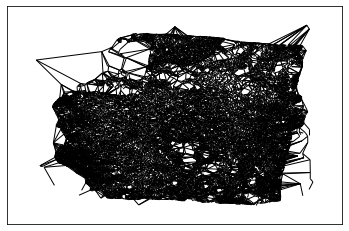

In [38]:
plt.figure()
nx.draw_networkx(mst_graph, pos=positions, with_labels=False, node_size = 0)
plt.show()

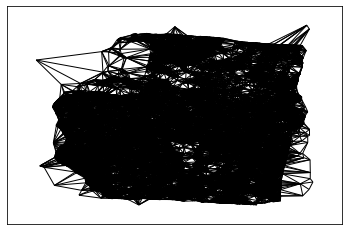

In [39]:
plt.figure()
nx.draw_networkx(delaunay_graph, pos=positions, with_labels=False, node_size = 0)
plt.show()

# 6. Geometric edges

## 6.1. Set positions as attributes

In [13]:
for node_name in delaunay_graph.nodes:
    delaunay_graph.nodes[node_name]['pos'] = positions[node_name]

In [14]:
nx.get_node_attributes(delaunay_graph, "pos")

{0: [16437, 16914],
 1: [9736, 16770],
 2: [16566, 16560],
 3: [7725, 16155],
 4: [8229, 16121],
 5: [8263, 16137],
 6: [8166, 16116],
 7: [8209, 16115],
 8: [8190, 16097],
 9: [7614, 16090],
 10: [7695, 16128],
 11: [8281, 16084],
 12: [8271, 16080],
 13: [7954, 16079],
 14: [8072, 16064],
 15: [8111, 16126],
 16: [8087, 16088],
 17: [8958, 16055],
 18: [7564, 16055],
 19: [9871, 16050],
 20: [9625, 16043],
 21: [7890, 16042],
 22: [9867, 16039],
 23: [9750, 16039],
 24: [9761, 16054],
 25: [8214, 16036],
 26: [8858, 16034],
 27: [8642, 16032],
 28: [8785, 16074],
 29: [8784, 16073],
 30: [8783, 16072],
 31: [8767, 16063],
 32: [8705, 16061],
 33: [8704, 16060],
 34: [8703, 16059],
 35: [8753, 16051],
 36: [9857, 16030],
 37: [8224, 16027],
 38: [8237, 16041],
 39: [8229, 16037],
 40: [9257, 16025],
 41: [8690, 16022],
 42: [8702, 16029],
 43: [8705, 16028],
 44: [9217, 16021],
 45: [9222, 16027],
 46: [8717, 16020],
 47: [8738, 16036],
 48: [8453, 16019],
 49: [8964, 16018],
 50: [77

## 6.2. Perform

In [17]:
list_radius1 = nx.geometric_edges(delaunay_graph, 1)

In [36]:
dict_radius = {}
for radius in range(1,111,10):
    dict_radius["list_radius{0}".format(radius)] = nx.geometric_edges(delaunay_graph, radius)

In [37]:
len(dict_radius["list_radius1"])

137

In [42]:
number_of_edges_radius = []
for number_of_edges in dict_radius.values():
    number_of_edges_radius.append((len(number_of_edges)))
number_of_edges_radius

[137,
 76531,
 211421,
 398145,
 637055,
 930021,
 1271339,
 1663998,
 2105929,
 2597762,
 3133946]

In [131]:
df_radius = pd.DataFrame(list(range(1,111,10)), columns = ['list_radius'])
df_radius['number_of_edges_radius'] = number_of_edges_radius
df_radius

,list_radius,number_of_edges_radius
0,1,137
1,11,76531
2,21,211421
3,31,398145
4,41,637055
5,51,930021
6,61,1271339
7,71,1663998
8,81,2105929
9,91,2597762


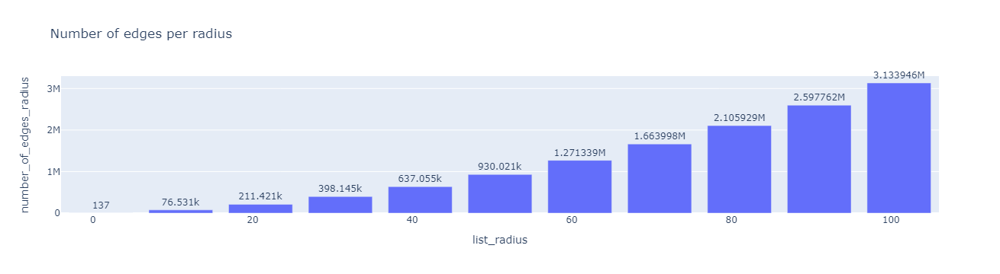

In [135]:
fig = px.bar(df_radius, x = 'list_radius', y = 'number_of_edges_radius',  title= "Number of edges per radius", text_auto=True)
fig.show()